In [1]:
import numpy as np
import cv2 as cv
from matplotlib import pyplot as plt

## Below are the functions for the filters based on the algorithm described in the question

In [27]:
def adaptiveMedianFilter(img1,h,wMax):
    img=np.copy(img1)
    paddedImg= np.pad(img, ((wMax, wMax), (wMax, wMax)), mode='constant')
    m,n=img.shape
    denoisedImage=np.zeros_like(img1)
    for i in range(m):
        for j in range(n):
            w=1
            while w<wMax:
                window=paddedImg[i+wMax-w:i+wMax+w + 1, j+wMax-w:j+wMax+w+1]
                yij=paddedImg[i+wMax,j+wMax]
                sMed=np.median(window.flatten())
                sMin=np.min(window.flatten())
                sMax=np.max(window.flatten())

                if sMin<sMed and sMed<sMax:
                    if yij>sMin and yij<sMax:
                        denoisedImage[i,j] = yij
                        break
                    else:
                        denoisedImage[i,j] =sMed
                        break

                else:
                    w+=h
                if w==wMax:
                    denoisedImage[i,j]=sMed

    return denoisedImage
def sMean_function(s,sMin,sMax):
    A=np.zeros_like(s)
    m,n=s.shape
    for i in range(m):
        for j in range(n):
            if  s[i,j]>sMin and s[i,j]<sMax:
                A[i,j]=1
            
    if np.sum(A)==0:
        Smean=-1
    else:
        Smean=(np.sum(np.multiply(A,s)))/np.sum(A)
    return Smean

def AWMF(img1,h,wMax):
    img=np.copy(img1)
    paddedImg= np.pad(img, ((wMax, wMax), (wMax, wMax)), mode='constant')
    m,n=img.shape
    denoisedImage=np.zeros_like(img1)
    for i in range(m):
        for j in range(n):
            w=1
            while w<wMax:
                window=paddedImg[i+wMax-w:i+wMax+w + 1, j+wMax-w:j+wMax+w+1]
                windowH=paddedImg[i+wMax+h-w:i+h+wMax+w + 1, j+h+wMax-w:j+h+wMax+w+1]
                yij=paddedImg[i+wMax,j+wMax]
                sMin=np.min(window.flatten())
                sMax=np.max(window.flatten())
                sMean=sMean_function(window,sMin,sMax)
                sMinH=np.min(windowH.flatten())
                sMaxH=np.max(windowH.flatten())
                if sMax==sMaxH and sMin==sMinH and sMean!=-1:
                    if yij>sMin and yij<sMax:
                        denoisedImage[i,j] = yij
                        break
                    else:
                        denoisedImage[i,j] =sMean
                        break
                else:
                    w+=h
                if w==wMax:
                    denoisedImage[i,j]=sMean
    return denoisedImage

def addSaltAndPepperNoise(image, saltVsPepper=0.5, amount=0.004):
    noisyImage = np.copy(image)
    numSalt = np.ceil(amount * image.size * saltVsPepper)
    numPepper = np.ceil(amount * image.size * (1.0 - saltVsPepper))
    saltCoords = [np.random.randint(0, i - 1, int(numSalt)) for i in image.shape]
    noisyImage[saltCoords[0], saltCoords[1]] = 255
    pepperCoords = [np.random.randint(0, i - 1, int(numPepper)) for i in image.shape]
    noisyImage[pepperCoords[0], pepperCoords[1]] = 0
    return noisyImage


## In this cell, I add some level of noise to the image, then denoise it with the AMF, and finally plot the results.


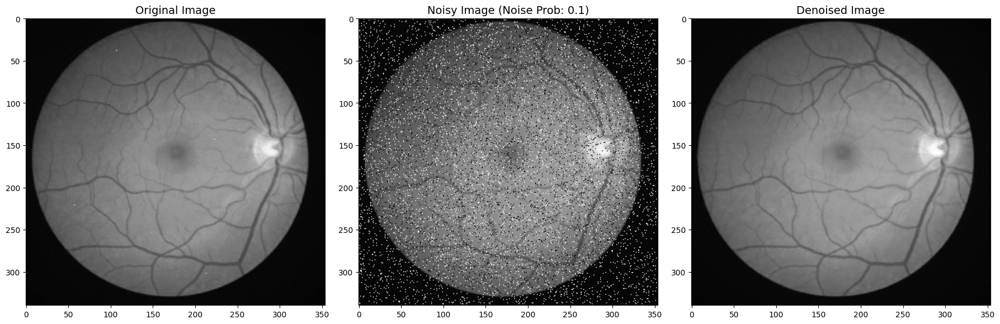

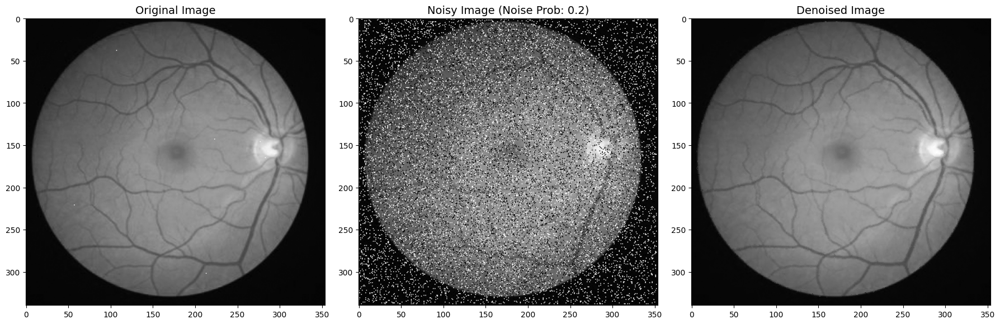

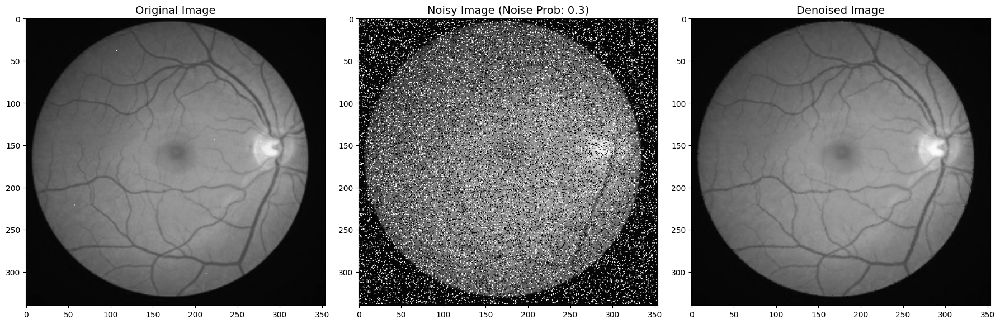

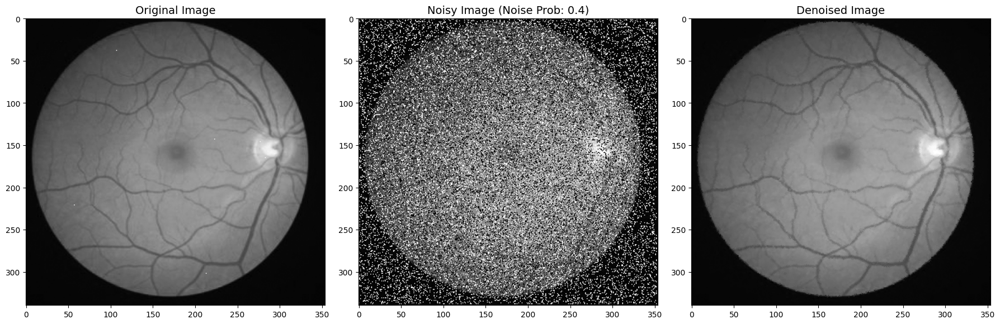

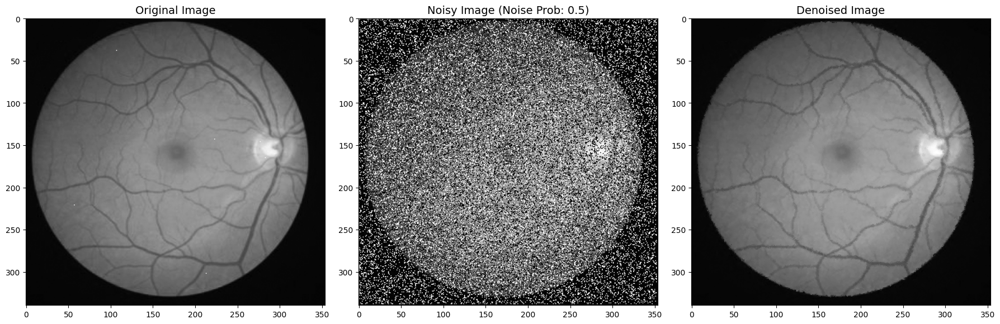

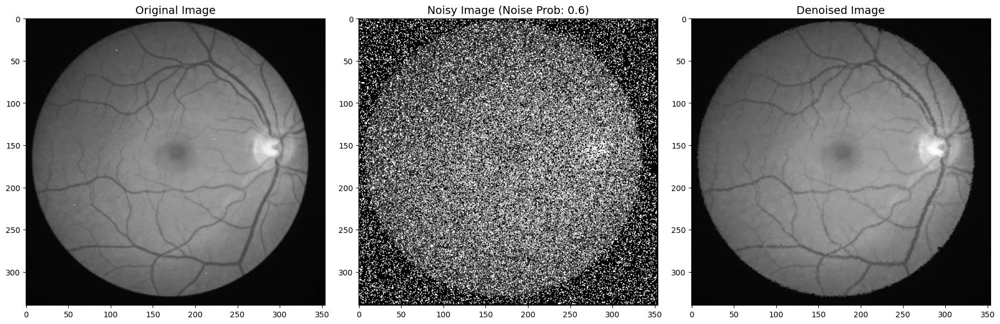

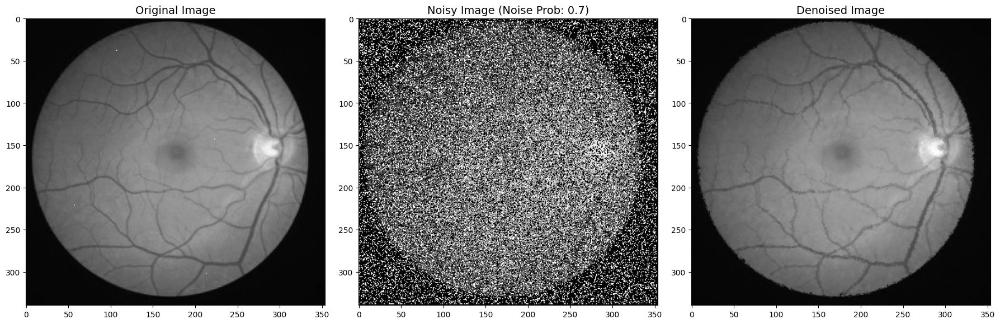

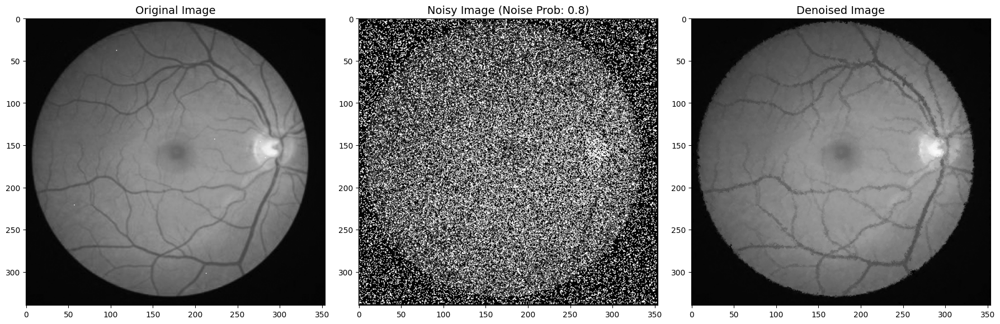

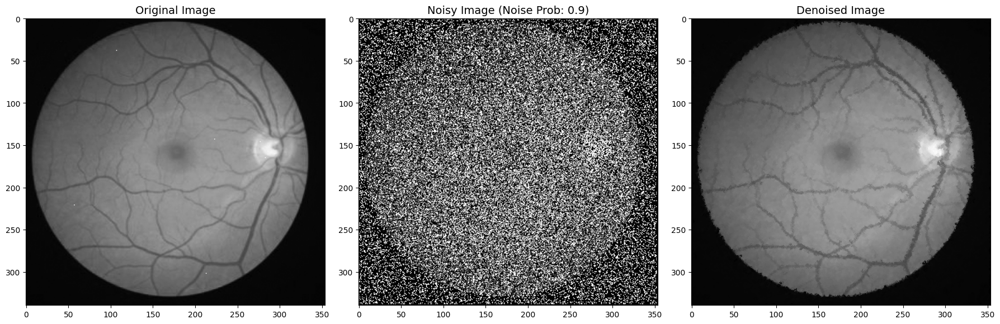

In [34]:
retinaImg = cv.imread('retina.png', 0)
mseNoisyList = []
snrNoisyList = []
psnrNoisyList = []
mseDenoisedListAMF = []
snrDenoisedListAMF = []
psnrDenoisedListAMF = []
for noiseProb in range(1, 10):
    noiseProb /= 10
    noisyImage = addSaltAndPepperNoise(retinaImg, 0.5, noiseProb)
    denoisedImageAMF = adaptiveMedianFilter(noisyImage, 1, 39)

    mseNoisy = np.mean((retinaImg - noisyImage) ** 2)
    mseDenoised = np.mean((retinaImg - denoisedImageAMF) ** 2)
    
    snrNoisy = 10 * np.log10(np.mean(retinaImg ** 2) / mseNoisy)
    snrDenoised = 10 * np.log10(np.mean(retinaImg ** 2) / mseDenoised)

    psnrNoisy = 10 * np.log10(255 ** 2 / mseNoisy)
    psnrDenoised = 10 * np.log10(255 ** 2 / mseDenoised)

    mseNoisyList.append(mseNoisy)
    snrNoisyList.append(snrNoisy)
    psnrNoisyList.append(psnrNoisy)
    mseDenoisedListAMF.append(mseDenoised)
    snrDenoisedListAMF.append(snrDenoised)
    psnrDenoisedListAMF.append(psnrDenoised)

    plt.figure(figsize=(18, 6))

    plt.subplot(1, 3, 1)
    plt.imshow(retinaImg, cmap='gray')
    plt.title('Original Image', fontsize=14)

    plt.subplot(1, 3, 2)
    plt.imshow(noisyImage, cmap='gray')
    plt.title(f'Noisy Image (Noise Prob: {noiseProb})', fontsize=14)

    plt.subplot(1, 3, 3)
    plt.imshow(denoisedImageAMF, cmap='gray')
    plt.title('Denoised Image', fontsize=14)

    plt.tight_layout()
    plt.show()


## In this cell, I add some level of noise to the image, then denoise it with AWMF, and finally plot the results.


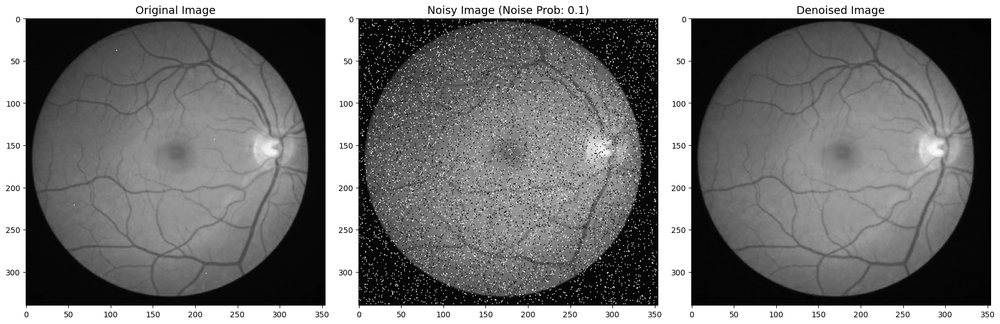

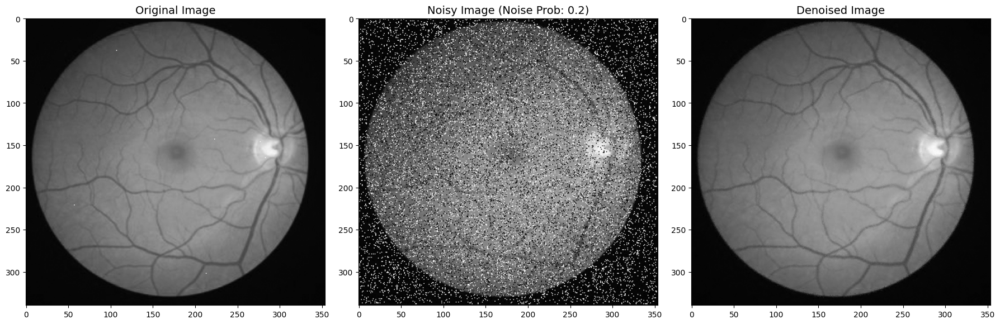

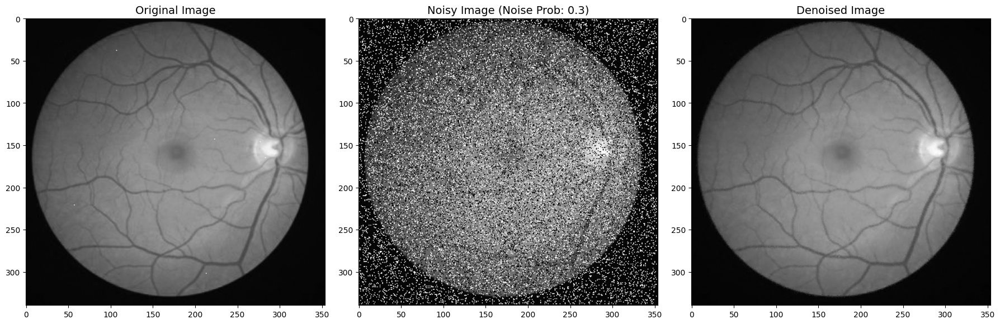

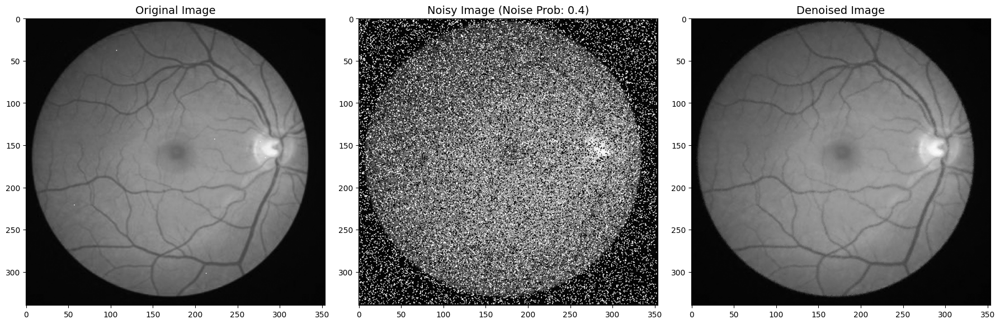

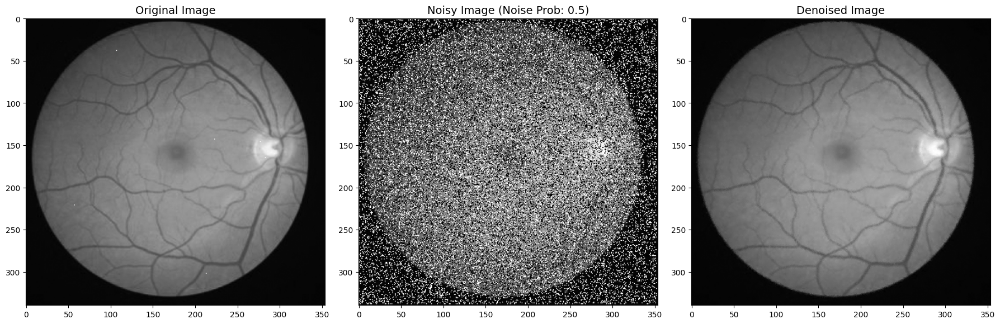

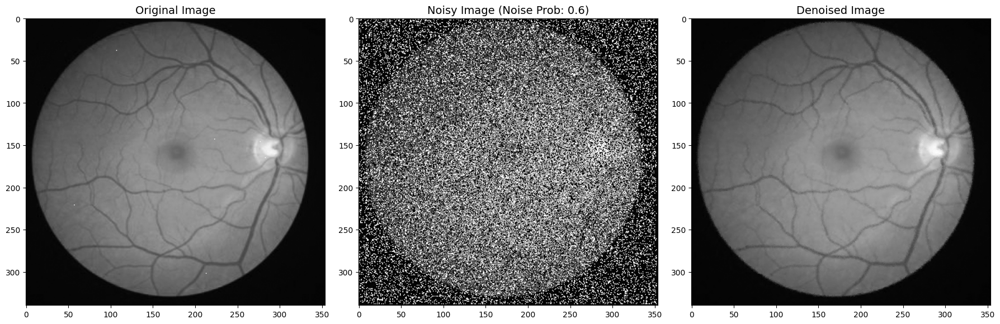

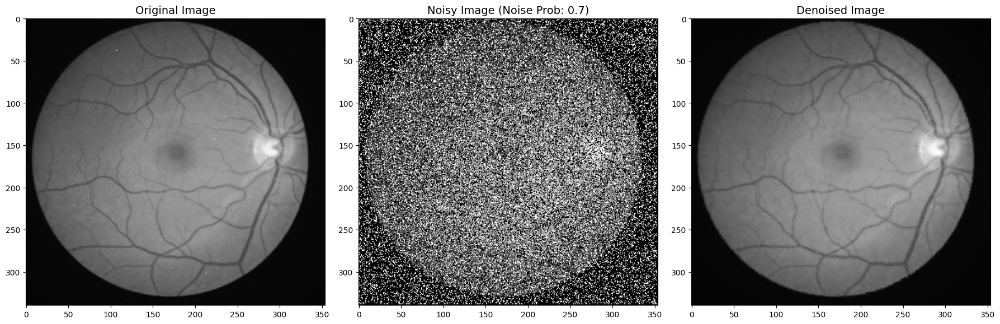

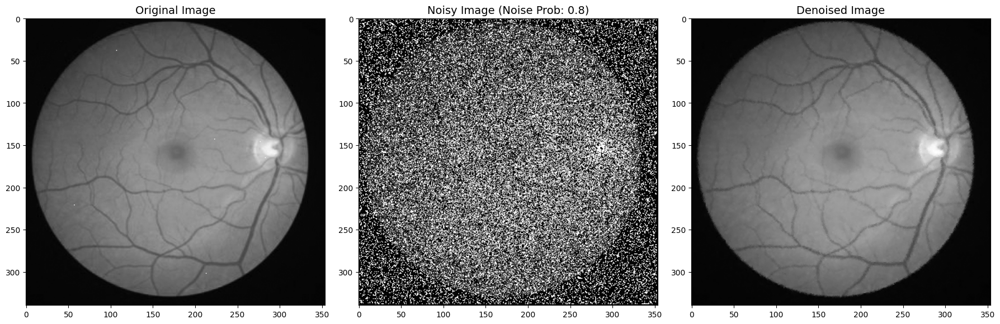

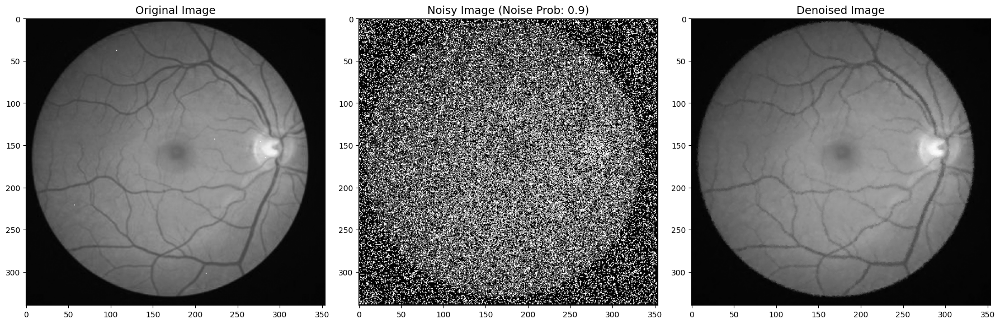

In [35]:
mseDenoisedListAWMF = []
snrDenoisedListAWMF = []
psnrDenoisedListAWMF = []

for noiseProb in range(1, 10):
    noiseProb /= 10
    noisyImage = addSaltAndPepperNoise(retinaImg, 0.5, noiseProb)
    denoisedImageAWMF = AWMF(noisyImage, 1, 39)
    mseDenoised = np.mean((retinaImg - denoisedImageAWMF) ** 2)
    snrDenoised = 10 * np.log10(np.mean(retinaImg ** 2) / mseDenoised)
    psnrDenoised = 10 * np.log10(255 ** 2 / mseDenoised)
    mseDenoisedListAWMF.append(mseDenoised)
    snrDenoisedListAWMF.append(snrDenoised)
    psnrDenoisedListAWMF.append(psnrDenoised)

    plt.figure(figsize=(18, 6))

    plt.subplot(1, 3, 1)
    plt.imshow(retinaImg, cmap='gray')
    plt.title('Original Image', fontsize=14)

    plt.subplot(1, 3, 2)
    plt.imshow(noisyImage, cmap='gray')
    plt.title(f'Noisy Image (Noise Prob: {noiseProb})', fontsize=14)

    plt.subplot(1, 3, 3)
    plt.imshow(denoisedImageAWMF, cmap='gray')
    plt.title('Denoised Image', fontsize=14)

    plt.tight_layout()
    plt.show()


#### Here, I plot the curves for Mean Squared Error (MSE), Peak Signal-to-Noise Ratio (PSNR), and Signal-to-Noise Ratio (SNR) for the noisy image, the image denoised with Adaptive Median Filter (AMF), and the image denoised with Adaptive Weighted Median Filter (AWMF).


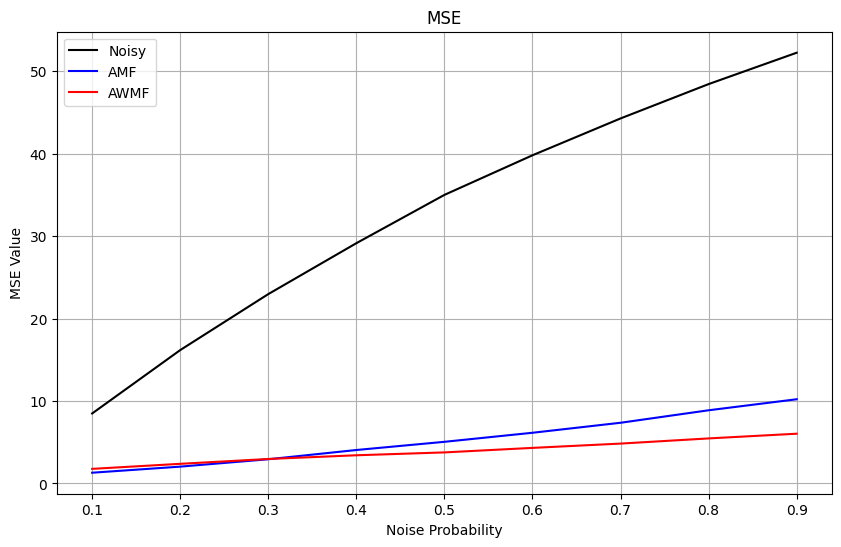

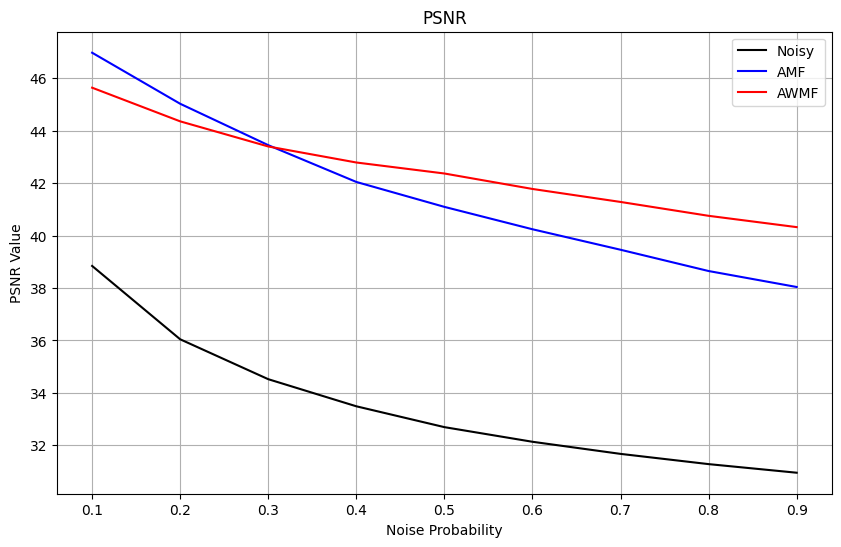

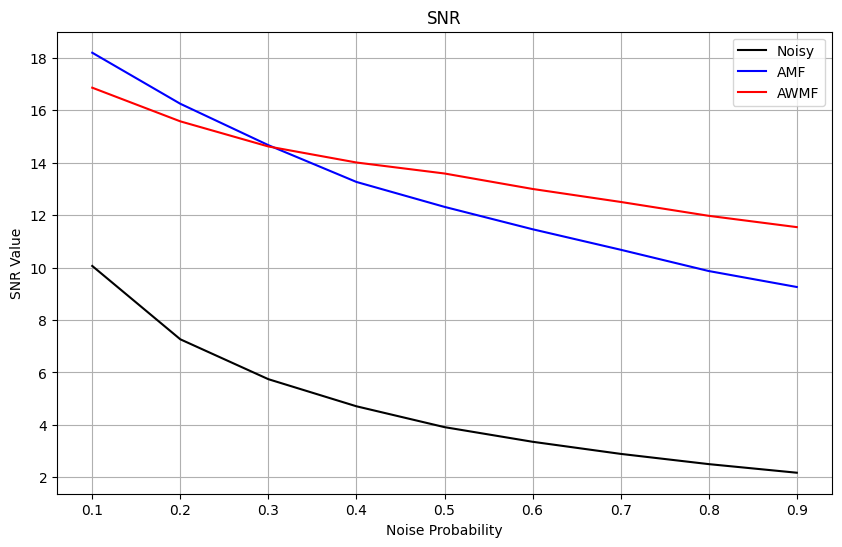

In [38]:
noiseprob = np.arange(0.1, 1, 0.1)
#MSE
plt.figure(figsize=(10, 6))
plt.plot(noiseprob, mseNoisyList, color='black', label='Noisy')
plt.plot(noiseprob, mseDenoisedListAMF, color='blue', label='AMF')
plt.plot(noiseprob, mseDenoisedListAWMF, color='red', label='AWMF')
plt.title('MSE')
plt.xlabel('Noise Probability')
plt.ylabel('MSE Value')
plt.legend()
plt.grid(True)
plt.show()

# PSNR
plt.figure(figsize=(10, 6))
plt.plot(noiseprob, psnrNoisyList, color='black', label='Noisy')
plt.plot(noiseprob, psnrDenoisedListAMF, color='blue', label='AMF')
plt.plot(noiseprob, psnrDenoisedListAWMF, color='red', label='AWMF')
plt.title('PSNR')
plt.xlabel('Noise Probability')
plt.ylabel('PSNR Value')
plt.legend()
plt.grid(True)
plt.show()

# SNR
plt.figure(figsize=(10, 6))
plt.plot(noiseprob, snrNoisyList, color='black', label='Noisy')
plt.plot(noiseprob, snrDenoisedListAMF, color='blue', label='AMF')
plt.plot(noiseprob, snrDenoisedListAWMF, color='red', label='AWMF')
plt.title('SNR')
plt.xlabel('Noise Probability')
plt.ylabel('SNR Value')
plt.legend()
plt.grid(True)
plt.show()
